In [ ]:
import os
import numpy as np
from PIL import Image
from torch.utils.data import Dataset, DataLoader, random_split
import torch
from torchvision import transforms
import torch.nn as nn
import torch.optim as optim
from torchvision import models
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

In [ ]:
class SegmentationDataset(Dataset):
    def __init__(self, images_dir, masks_dir, transform=None):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.transform = transform
        self.image_filenames = os.listdir(images_dir)

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        image_name = self.image_filenames[idx]
        image_path = os.path.join(self.images_dir, image_name)
        image = Image.open(image_path).convert("RGB")

        mask_name = image_name
        mask_path = os.path.join(self.masks_dir, mask_name)
        mask = Image.open(mask_path).convert("L")

        mask = np.array(mask)
        mask = np.clip(mask, 0, 9)
        mask = torch.tensor(mask, dtype=torch.long)

        if self.transform:
            image = self.transform(image)

        return image, mask

In [ ]:
train_images_dir = "/content/drive/MyDrive/Deep_Data/training/training/images"
train_masks_dir = "/content/drive/MyDrive/Deep_Data/training/training/groundtruth"
test_images_dir = "/content/drive/MyDrive/Deep_Data/Test_Images"

In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]) ])

In [ ]:
train_dataset = SegmentationDataset(train_images_dir, train_masks_dir, transform)

train_dataset, val_dataset = train_test_split(train_dataset, test_size=0.2, random_state=42)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)

In [ ]:
class TestDataset(Dataset):
    def __init__(self, images_dir, transform=None):
        self.images_dir = images_dir
        self.transform = transform
        self.image_filenames = os.listdir(images_dir)

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        image_name = self.image_filenames[idx]
        image_path = os.path.join(self.images_dir, image_name)
        image = Image.open(image_path).convert("RGB")

        if self.transform:
            image = self.transform(image)

        return image



In [ ]:
test_dataset = TestDataset(test_images_dir, transform)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

In [ ]:
model = models.segmentation.deeplabv3_resnet101(pretrained=True)
model.classifier[4] = nn.Conv2d(256, 10, kernel_size=1)
model = model.to('cuda')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth
100%|██████████| 233M/233M [00:01<00:00, 225MB/s]


In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0003   , weight_decay = 0.0001)

In [ ]:
num_epochs = 35
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    all_preds = []
    all_targets = []

    for images, masks in train_loader:
        images = images.to('cuda')
        masks = masks.to('cuda')

        optimizer.zero_grad()
        outputs = model(images)['out']
        if torch.any(torch.isnan(outputs)) or torch.any(torch.isinf(outputs)):
            print("NaN or Inf detected in the outputs!")
            continue

        output_class = torch.argmax(outputs, dim=1)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        all_preds.extend(output_class.cpu().flatten().numpy())
        all_targets.extend(masks.cpu().flatten().numpy())

    train_f1 = f1_score(all_targets, all_preds, average='weighted')
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}, Train F1: {train_f1:.4f}, Train Accuracy: {train_f1:.4f}')


Epoch [1/35], Train Loss: 1.6938, Train F1: 0.7492, Train Accuracy: 0.7492
Epoch [2/35], Train Loss: 1.0389, Train F1: 0.8778, Train Accuracy: 0.8778
Epoch [3/35], Train Loss: 0.7849, Train F1: 0.9049, Train Accuracy: 0.9049
Epoch [4/35], Train Loss: 0.6048, Train F1: 0.9208, Train Accuracy: 0.9208
Epoch [5/35], Train Loss: 0.4862, Train F1: 0.9298, Train Accuracy: 0.9298
Epoch [6/35], Train Loss: 0.4043, Train F1: 0.9380, Train Accuracy: 0.9380
Epoch [7/35], Train Loss: 0.3413, Train F1: 0.9432, Train Accuracy: 0.9432
Epoch [8/35], Train Loss: 0.2933, Train F1: 0.9487, Train Accuracy: 0.9487
Epoch [9/35], Train Loss: 0.2600, Train F1: 0.9514, Train Accuracy: 0.9514
Epoch [10/35], Train Loss: 0.2297, Train F1: 0.9550, Train Accuracy: 0.9550
Epoch [11/35], Train Loss: 0.2079, Train F1: 0.9581, Train Accuracy: 0.9581
Epoch [12/35], Train Loss: 0.1947, Train F1: 0.9586, Train Accuracy: 0.9586
Epoch [13/35], Train Loss: 0.1807, Train F1: 0.9607, Train Accuracy: 0.9607
Epoch [14/35], Train 

In [ ]:
model.eval()
all_preds = []
all_targets = []

with torch.no_grad():
    for images, masks in val_loader:
        images = images.to('cuda')
        masks = masks.to('cuda')

        outputs = model(images)['out']
        output_class = torch.argmax(outputs, dim=1)
        all_preds.extend(output_class.cpu().flatten().numpy())
        all_targets.extend(masks.cpu().flatten().numpy())

    val_f1 = f1_score(all_targets, all_preds, average='weighted')
    print(f'Validation F1: {val_f1:.4f}')


Validation F1: 0.9300


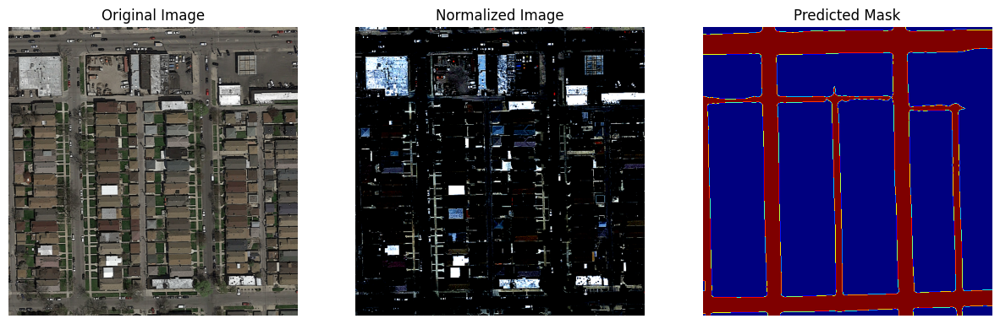

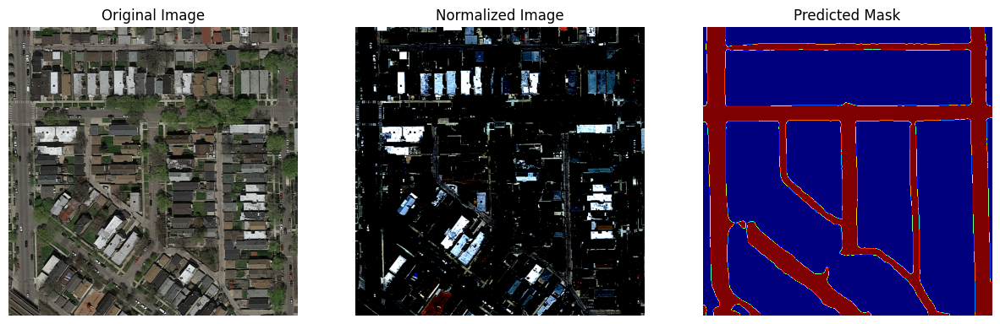

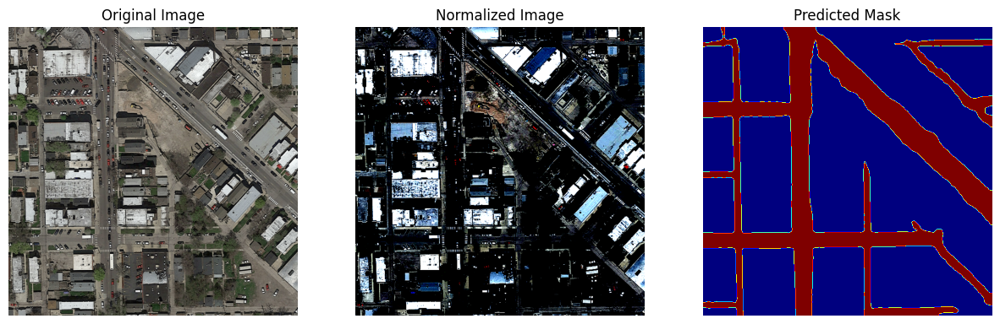

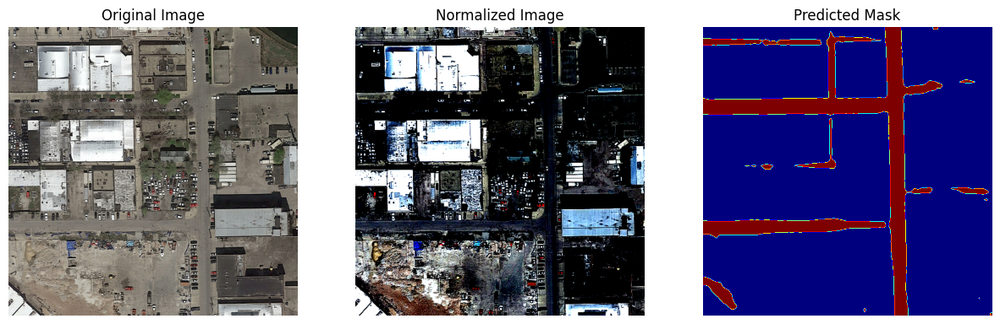

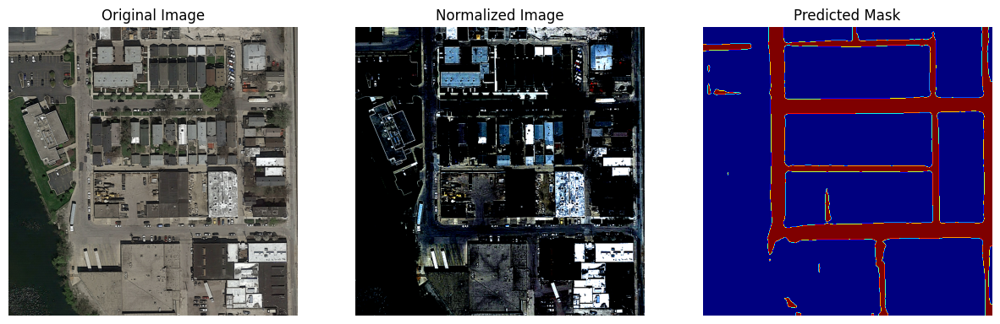

...

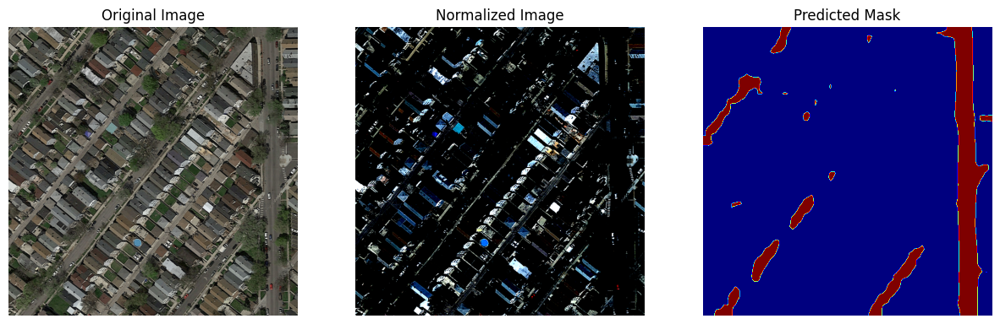

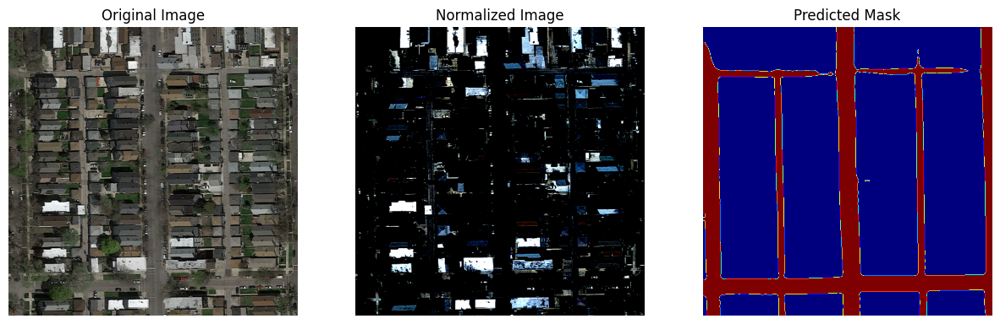

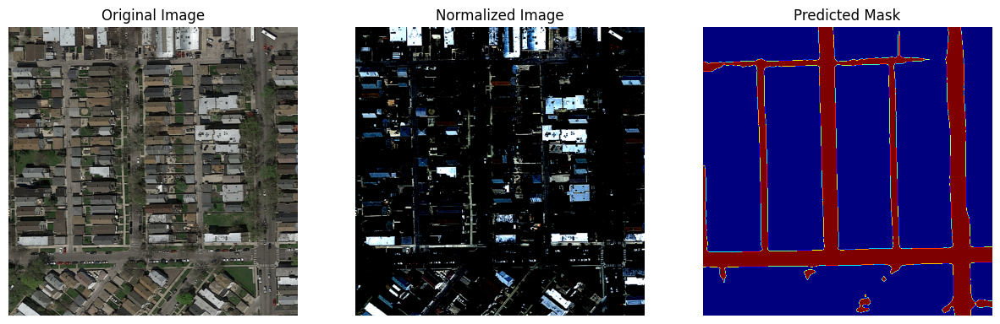

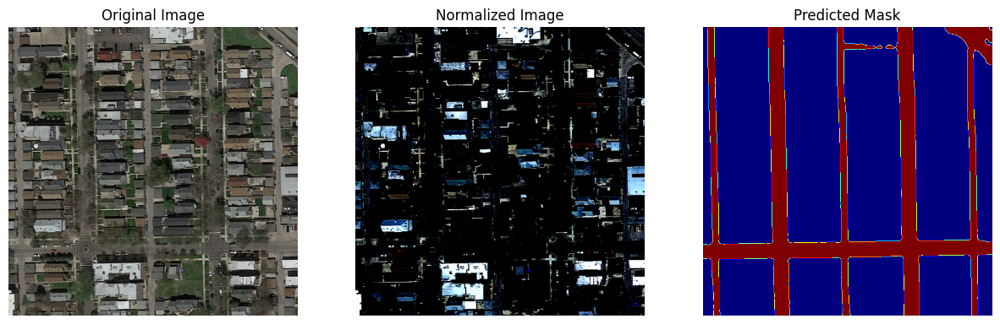

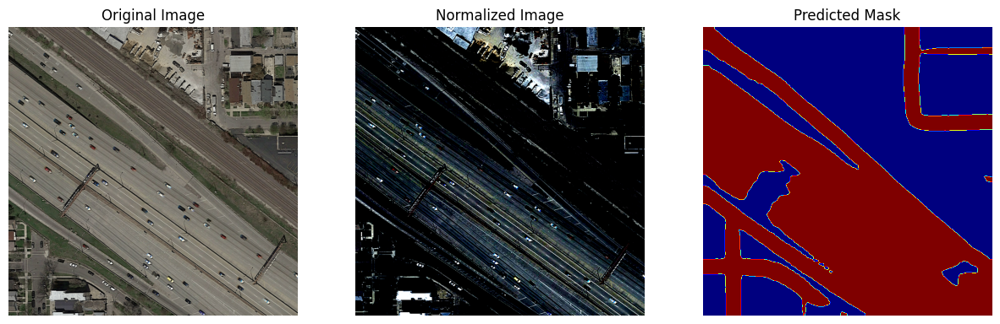

In [ ]:
test_images_dir = "/content/drive/MyDrive/Deep_Data/Test_Images"
model.eval() 


image_filenames = os.listdir(test_images_dir)

for image_filename in image_filenames:
   
    image_path = os.path.join(test_images_dir, image_filename)

    
    original_image = Image.open(image_path).convert("RGB")

   
    image = transform(original_image)
    image = image.unsqueeze(0).to('cuda')  

   
    with torch.no_grad():
        outputs = model(image)['out']
        predicted_mask = torch.argmax(outputs, dim=1)

    
    normalized_image = image[0].cpu().permute(1, 2, 0)
    predicted_mask = predicted_mask[0].cpu().numpy()

    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    
    axes[0].imshow(original_image)
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    
    axes[1].imshow(normalized_image)
    axes[1].set_title('Normalized Image')
    axes[1].axis('off')

    
    axes[2].imshow(predicted_mask, cmap='jet')  
    axes[2].set_title('Predicted Mask')
    axes[2].axis('off')

    plt.show()

In [14]:
state = {
    'epoch': epoch + 1,  
    'state_dict': model.state_dict(),  
    'optimizer': optimizer.state_dict()  
}


torch.save(state, 'model_checkpoint.pth')